# Resources
- Jake VanderPlas' [Minimal code](http://jakevdp.github.io/blog/2013/08/07/conways-game-of-life/)
- Bert Chan's [Google notebook](https://colab.research.google.com/github/OpenLenia/Lenia-Tutorial/blob/main/Tutorial_From_Conway_to_Lenia.ipynb#scrollTo=mbSw3-6lac1s)
- Computerfile explanation of [kernals](https://www.youtube.com/watch?v=C_zFhWdM4ic)

# Game of Life
Code inspired by Jake VanderPlas' [Minimal code](http://jakevdp.github.io/blog/2013/08/07/conways-game-of-life/). Ammended to my style and editted to use only animation tools included in matplotlib package (removing us of JSanimation package, which was buggy). 

Game of life comprises a 2dimensional gridspace where each cell can take on a binary {0,1} value, "dead" or "alive". The grid is populated with an initial configuration, and each timestep all cells are updated according to a local rule. The emergent chaotic patterns resemble the dynamics of biological organisms. Rules governing each generation are as follows: 
- If a living cell is surrounded by more than 3 living cells, it dies (**overpopulation**)
- If a living cell is surrounded by 2 or 3 living cells, it survives (**stasis**)
- If a living cells is surrounded by fewer than two living cells, it dies (**underpopulation**)
- If a dead cell is surrounded by exactly three cells, it becomes a live cell (**Reproduction**)

Below methods use scipy convolution2d to calculate the neighbourhood of each cell in each timestep. Note methods below are not optimal for larger data sets, since they involve creating several temporary arrays. 

## Basic Code

In [12]:
## IMPORTS ## 
import numpy as np
import scipy as sc
import matplotlib.pyplot as plt
from matplotlib import animation

# For displaying animations in jupyter notebook
from matplotlib import rc
from IPython.display import HTML, Image


In [13]:
## FUNCTIONS ##

def life_step(x):
    """Performs time step in game of life using scipy.
    Convolves each cell with neighbourhood kernal and takes sum of kernal minus cell value.
    Returns updated board according to local rules of birth, death and survival"""
    from scipy.signal import convolve2d
    nbrs_count = convolve2d(x, np.ones((3, 3)), mode="same",
                            boundary='wrap') - x  # Produces a matrix where each cell represents its neighbourhood sum
    return (nbrs_count == 3) | (x & (nbrs_count == 2))

*NOTE TO SELF* - Above function works by convolving input x by kernal, producing array of neighbourhood sums, and then returning another array based on this array of sums and value of x. Could optimise by removing need for so many temporary arrays. 

In [14]:
def animate_life(x, dpi=10, frames=10, interval=200, mode = "loop"):
    """Produce a Game of Life Animation

    Parameters
    ------------
    X: array_like
        a two-dimensional numpy array showing the game board
    dpi: integer
        the number of dots per inch in the resulting anmation.
        This contols the size of the game board on the screen.
    frames: integer
        The number of frames to compute for the animation
    interval: float
        The time interval (in milliseconds) between frames
    mode: string
        The default mode fo the animation. Option include ['loop'|'once'| reflect]
    """

    # Handle input x
    x = np.asarray(x)  # Convert to np array
    assert x.ndim == 2  # Throw error if x is not 2 dimensions
    x = x.astype(bool)  # Convert all 0 and 1 to true/false
    
    # Initiate figure
    x_blank = np.zeros_like(x)  # Create blank plot of x, for background of animation

    figsize = (x.shape[1] * 1. / dpi, x.shape[0] * 1. / dpi)
    dpi = 10
    fig = plt.figure(figsize=figsize, dpi=dpi)  # Initiate figure with given size and dots per inch (dpi)
    ax = fig.add_axes([0, 0, 1, 1], xticks=[], yticks=[], frameon=False)
    im = ax.imshow(x, cmap=plt.cm.binary, interpolation="nearest")  # Arrange features of image (colour etc)
    im.set_clim(-0.05, 1)  # make background grey
    
    # Set up animation
    def init():
        """Initialise blank function plot"""
        im.set_data(x_blank)
        return im,


    def animate(i):
        """Animation function. Called sequentially with animation.FunAnime below.
        Updates x with new life step and sets data in image (im)"""
        im.set_data(animate.x)
        animate.x = life_step(animate.x)
        return im,


    animate.x = x  # Set initial conditions for x

    # Animate
    anim = animation.FuncAnimation(fig, animate, init_func=init,
                            frames=frames, interval=interval)
    return anim

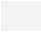

In [15]:
## TRY WITH ONE CONFIGURATION OF X: 
np.random.seed(123)
x = np.zeros((30, 40), dtype=bool)
r = np.random.random((10, 20))  # Populate middle section with lives randomely
x[10:20, 10:30] = (r > 0.75)


rc("animation", html = "html5")

animate_life(x)

## Fun Configurations

In [16]:
# Stable local patterns- self sustaining/reinforcing. 
# OSCILLATORS (toad and blinkers)
blinker = [1,1,1]
toad = [[1, 1, 1, 0],
       [0, 1, 1, 1]]

x = np.zeros((6, 11))
x[2, 1:4] = blinker
x[2:4, 6:10] = toad

animate_life(x)

In [17]:
# GLIDER
glider = [[1, 0, 0], 
         [0, 1, 1], 
         [1, 1, 0]]
x = np.zeros((8, 8))
x[:3, :3] = glider
animate_life(x, dpi=5, frames=32, interval=100)

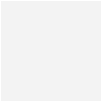

In [18]:
# UNBOUNDED GROWTH
unbounded = [[1, 1, 1, 0, 1],
             [1, 0, 0, 0, 0],
             [0, 0, 0, 1, 1],
             [0, 1, 1, 0, 1],
             [1, 0, 1, 0, 1]]
x = np.zeros((100, 100))
x[15:20, 18:23] = unbounded
animate_life(x)

# Generalising Game of life
Lenia takes GOL and generalises it, then extends it by making state, space and time continuous. The above code for GOL deals with discrete states and timesteps, each timestep the neighbourhood sum is calculated and a new evaluation is given based on values in U. Above code already uses convolution by Kernel to find sum of neighbourhood, though this can also be calculated using a simple summing of parts. Usage of a Kernel generalises game as Kernel can be editted to ammend how neighbourhood is evaluated. 

Once the neighbourhood sum is calculated, this can be further generalised by introducing a growth function which determines growth/shrinkage of a cell based on the values in the neighbourhood sum. This gives more flexibility regarding how neighbourhood sums influence next state of the cell. 

In [19]:
## PRELIMINARIES
%matplotlib inline
import numpy as np
import matplotlib.pylab as plt
import matplotlib.animation
import IPython.display
from scipy.signal import convolve2d

np.warnings.filterwarnings('ignore', category=np.VisibleDeprecationWarning)                 

## FUNCTIONS
def figure_world(A, cmap="viridis"):
    """Set up basic graphics of unpopulated, unsized world"""
    global img  # make final image global
    fig = plt.figure()  # Initiate figure
    img = plt.imshow(A, cmap=cmap, interpolation="nearest", vmin=0)  # Set image
    plt.title = ("World A")
    plt.close()
    return fig

# For as we begin producing more complex Kernels and growth functions
def figure_asset(K, growth, cmap="viridis", K_sum=1, bar_K=False):
    """Configures Graphical representations of input Kernel and growth function.
        The first plot on ax[0] demonstrates values of the Kernel across 0, 1, 2 columns
        ax[1] Gives cross section of the Kernel, ie. plots the values of row 1 (middle row of 3x3 kernel), around the target cell
        ax[2] Gives effect of Growth Kernel for different values of U. Negative or positive growth.
    """
    global R
    K_size = K.shape[0];
    K_mid = K_size // 2  # Get size and middle of Kernel
    fig, ax = plt.subplots(1, 3, figsize=(14, 2),
                           gridspec_kw={"width_ratios": [1, 1, 2]})  # Initiate figures with subplots

    ax[0].imshow(K, cmap=cmap, interpolation="nearest", vmin=0)
    ax[0].title.set_text("Kernel_K")

    if bar_K:
        ax[1].bar(range(K_size), K[K_mid, :], width=1)  # make bar plot
    else:
        ax[1].plot(range(K_size), K[K_mid, :])  # otherwise, plot normally
    ax[1].title.set_text("K cross-section")
    ax[1].set_xlim([K_mid - R - 3, K_mid + R + 3])

    if K_sum <= 1:
        x = np.linspace(0, K_sum, 1000)
        ax[2].plot(x, growth(x))
    else:
        x = np.arange(K_sum + 1)
        ax[2].step(x, growth(x))
    ax[2].axhline(y=0, color="grey", linestyle="dotted")
    ax[2].title.set_text("Growth G")
    return fig

def figure_asset_list(Ks, nKs, growth, kernels, use_c0=False, cmap='viridis', K_sum=1):
    global R
    K_size = Ks[0].shape[0];
    K_mid = K_size // 2
    fig, ax = plt.subplots(1, 3, figsize=(14, 2), gridspec_kw={'width_ratios': [1, 2, 2]})
    if use_c0:
        K_stack = [np.clip(np.zeros(Ks[0].shape) + sum(K / 3 for k, K in zip(kernels, Ks) if k['c0'] == l), 0, 1) for l
                   in range(3)]
    else:
        K_stack = Ks[:3]
    ax[0].imshow(np.dstack(K_stack), cmap=cmap, interpolation="nearest", vmin=0)
    ax[0].title.set_text('kernels Ks')
    X_stack = [K[K_mid, :] for K in nKs]
    ax[1].plot(range(K_size), np.asarray(X_stack).T)
    ax[1].title.set_text('Ks cross-sections')
    ax[1].set_xlim([K_mid - R - 3, K_mid + R + 3])
    x = np.linspace(0, K_sum, 1000)
    G_stack = [growth(x, k['m'], k['s']) * k['h'] for k in kernels]
    ax[2].plot(x, np.asarray(G_stack).T)
    ax[2].axhline(y=0, color='grey', linestyle='dotted')
    ax[2].title.set_text('growths Gs')
    return fig


## i. Incremental growth
Firstly, we will use an incremental growth function and clipping instead of a conditional update. While the original GOL evaluates each cell of a neighbourhood sum U and returns a 0 or 1 based on local rules, use of a growth function allows more control over conditions of growth/shrinkage. The growth function takes our neighbourhood sums U, and produces a growth matrix based on values in U, comprised of 1 and -1 (growth and shrinkage). 

In this step, the growth distribution is then added to our grid A, and clipped to keep values between 0 and 1. 

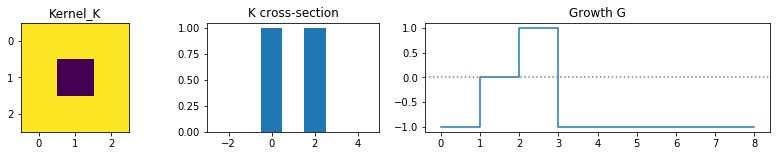

In [20]:
# Set values 
R = 1
size = 64
np.random.seed(0)
A = np.random.randint(2, size=(size, size))  # Initiate grid
K = np.ones((3, 3))
K[1, 1] = 0
K_sum = np.sum(K)

def growth(U):
    """Define growth function with growth/shrink ranges.
    Take neighborhood sum as input.
    The two logical values below are mutually exlusive. One will evaluate to 1
    and the other to zero.
    Returned values for each cell will be -1 or 1.
    Once clipped this gives us 1, or 0."""
    return 0 + (U == 3) - ((U < 2) | (U > 3))

def update(i):
    global A
    U = convolve2d(A, K, mode='same', boundary="wrap")
    """Use incremental update and clipping. Instead of simple conditional"""  #
    # A = (A & (U==2)) | (U==3)
    A = np.clip(A + growth(U), 0, 1)  # Add growth distribution to grid and clip
    img.set_array(A)
    return img,

# Generate Kernel and Growth assets
figure_asset(K, growth, K_sum=int(K_sum), bar_K=True)

# Generate game 
fig = figure_world(A, cmap="binary")
IPython.display.HTML(matplotlib.animation.FuncAnimation(fig, update, frames=50, interval=50).to_jshtml())

Above three plots: 
1. Shows kernel in matrix form plotted in 3x3 axis
2. Shows value of cross-section of kernel[1,] (ie. middle row of kernel [1,0,1])
3. Shows growth and shrinkage based on input values. Where 1 <= U >= 3, cell is stable. U ==2 or U == 3, cell grows. In all other cases cell shrinks. 

# Extending GOL
With convolution of kernel and use of growth function, the above system is now fully generalised. It can be extended into various continuous cases, by ammending the kernel and growth function. 

## Larger than life
The cellular automata (CA) larger than life makes the game of life space continuous by englarging the Kernel to Radius R, thus extending the Moore Neighbourhood. It then uses ranges for growth and shrinkage to find growth distribution.

In [21]:
# Set values
size = 64; cx, cy = 10, 10
R = 5
A = np.random.randint(2, size=(size, size))
K = np.ones((2*R+1, 2*R+1))

# Define birth ranges and stable ranges
b1 = 34; b2= 45; s1=34; s2 = 58

K_sum = np.sum(K)
K  # Simple mean Kernel, just larger

array([[1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
       [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
       [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
       [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
       [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
       [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
       [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
       [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
       [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
       [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
       [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.]])

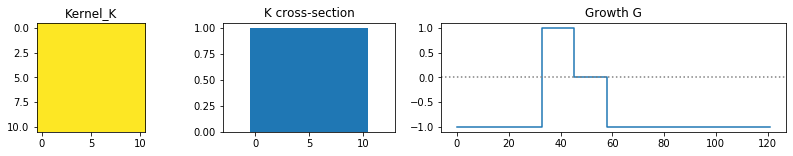

In [22]:
def growth(U):
    """
     b1..b2 is birth range
     s1..s2 is stable range (outside of s1..s2 is shrink).
     Below, if U is within the stable range, the second term will evaluate to zero.
     If it is outside of the stable range, it will evalate to 1.
     Needs to be within stable and birth range to be born"""
    return 0 + ((U >= b1) & (U <= b2)) - ((U < s1) | (U > s2))

def update(i):
    """Convolve by Kernel to get neighbourhood sum,
    then find growth distribution and add to grid, clipping between 0 and 1"""
    global A
    U = convolve2d(A, K, mode="same", boundary="wrap")
    A = np.clip(A + growth(U), 0, 1)
    img.set_array(A)
    return img,

figure_asset(K, growth, K_sum=K_sum, bar_K=True)
fig = figure_world(A, cmap='binary')
IPython.display.HTML(matplotlib.animation.FuncAnimation(fig, update, frames=200, interval=50).to_jshtml())

## Primordia 
Primordia uses continuous states and time. Firstly, let's allow multiple states, extending GOL's binary of dead or alive. To do this, we need to scale our growth/shrinkage ranges by the number of states as well. The patterns produced become visibly more complex. 
### i. Multiple states

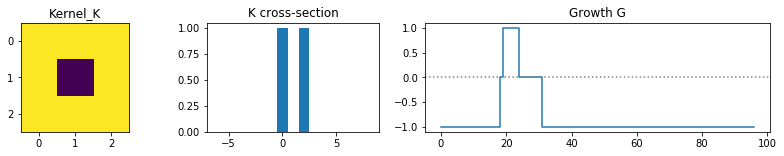

In [23]:
## MULTIPLE STATES

# set values
states = 12  # allow 12 states
np.random.seed(0)
A = np.random.randint(states + 1, size=(size, size))  # Generate grid with random states
K = np.ones((3, 3))  # Use standard Moore Neighborhood
K[1, 1] = 0
K_sum = states * np.sum(K)  # Sum equals sum * number of states7


def growth(U):
    """Scale everything up by number of states"""
    return 0 + ((U >= 20) & (U <= 24)) - ((U <= 18) | (U >= 32))

def update(i):
    global A
    U = convolve2d(A, K, mode="same", boundary="wrap")
    A = np.clip(A + growth(U), 0, states)
    img.set_array(A)
    return img,

figure_asset(K, growth, K_sum=K_sum, bar_K=True)
fig = figure_world(A)
IPython.display.HTML(matplotlib.animation.FuncAnimation(fig, update, frames=200, interval=20).to_jshtml())

### ii. Normalised Kernel
Can normalise the properties of the system by keeping their values between [0:1]- this will make the system easier to generalise as we can change the number of states without needing to ammend the growth and shrinkage parameters. Below we normalise the system by normalising the Kernel and growth function.

In [24]:
## NORMALISE VALUES
size = 64
states = 12  # same number of states
np.random.seed(0)
A = np.random.randint(states+1, size=(size, size))  # Generate grid of random states
K = np.ones((3,3))  # Same Kernel as above
K[1,1] = 0
K_sum = states * np.sum(K)

# Normalise kernel
K = K/K_sum  # keeps values between 0:1

def growth(U):
    """Normalise growth/shrink ranges, divide each number by K_sum"""
    return 0 + ((U >= 0.2) & (U <= .25)) - ((U <= 0.19) | (U >= 0.33))

def update(i):
    global A
    U = convolve2d(A, K, mode="same", boundary="wrap")
    A = np.clip(A + growth(U), 0, states)
    img.set_array(A / states)
    return img,

# NO CHANGE IN PATTERN OR CROSS-SECTIONS FROM ABOVE

### iii. Continuous states and time
Lastly, we can normalise discrete number of states to a range between [0:1], making them effectively continuous. 

We can also define an update frequency T, with incremental updates dt = 1/T. By taking T to infinity, our timesteps dt become infinitely small, thus time also becomes continuous

In [25]:
# CONTINUOUS STATES AND TIME
T = 10
size = 64
# state = 12

np.random.seed(0)
A = np.random.rand(size, size)  # Generate random states [0:1]
K = np.ones((3,3))
K[1,1] = 0
K = K/np.sum(K)  # Normalised Moore neighborhood

# Growth remains unchanged

def update(i):
    """Update each step with 1/ T growth"""
    global A
    U = convolve2d(A, K, mode="same", boundary="wrap")
    A = np.clip(A + 1/T*growth(U), 0, 1)  # Each timestep, grow only by 1/t
    img.set_array(A)
    return img,

# AGAIN, PATTERNS DO NOT CHANGE

## Lenia: Continuous time, space and states
Above system generalises GOL and extends it to allow continuous time and states. Lenia takes this one further by introducing continuous space as well. 

Here, the kernel is enlarged to Radius R as in Larger than life (still remains rectangular).
As R approaches infinity, space too becomes continuous. Patterns produced appear much more fluid and smooth.

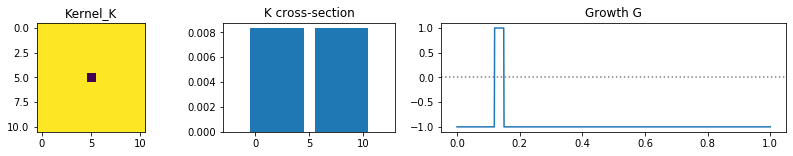

In [26]:
## CONTINUOUS SPACE TIME AND STATES
R = 5
np.random.seed(0)
A = np.random.rand(size, size)  # Populate grid with random states
"""Define a Larger rectanglar kernel"""
K = np.ones((2 *R+1, 2*R+1)); K[R, R] = 0  # Center is still zero
K = K/np.sum(K)  # normalise

# Growth stays the same, but changing ranges
def growth(U):
    """Normalise growth/shrink ranges, divide each number by K_sum"""
    return 0 + ((U >= 0.12) & (U <= .15)) - ((U <= 0.12) | (U >= 0.15))

# Update also the same, just with larger Kernel
def update(i):
    global A
    U = convolve2d(A, K, mode="same", boundary="wrap")
    A = np.clip(A + 1/T*growth(U), 0, 1)
    img.set_array(A)
    return img,

figure_asset(K, growth, bar_K=True)
fig = figure_world(A)
IPython.display.HTML(matplotlib.animation.FuncAnimation(fig, update, frames=200, interval=20).to_jshtml())

### Ring Kernel
We can hand-draw a ring-like kernel with the same radius. This should remove the orthogonal bias in the patterns (horizontal and vertical stripes), making them equal in all directions. 

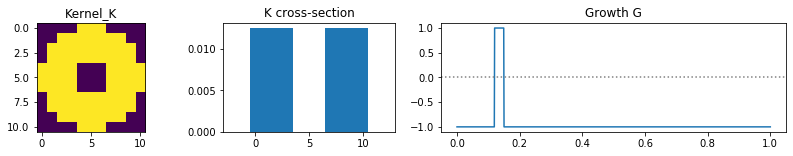

In [27]:
# USE RING-LIKE KERNEL
np.random.seed(0)
A = np.random.rand(size, size)

# Create ring-like Kernel
K = np.asarray([
[0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0],
[0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0],
[0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0],
[0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0],
[1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1],
[1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1],
[1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1],
[0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0],
[0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0],
[0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0],
[0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0]])
K = K / np.sum(K)

# Growth and Update functions stay the same
figure_asset(K, growth, bar_K=True)
fig = figure_world(A)
IPython.display.HTML(matplotlib.animation.FuncAnimation(fig, update, frames=200, interval=20).to_jshtml())

See ring-like shape above. Notice, greater blank space in cross-section as well.

### Smooth Kernel
Instead of hand-drawing as above, we can also produce it using a smooth bell-shaped function (Gaussian curve). Firtly, we define a distance Matrix D from the center, normalised by a factor of 1/R.

Distance matrix D gives the Euclidean distance of each point. Calculated as the square root of sum of absolute values squared:
$$
||A||_F = \sqrt{\Sigma_{i,j}abs(a_{i,j})^2}
$$

We can then feed this Distance matrix into the gaussian function which will give us a gradient of values around the center.

By convolving A with this Kernel, the neighbourhood sum U becomes a weighted sum where the Kernel defines the weights. This makes the resultant pattern smoother.

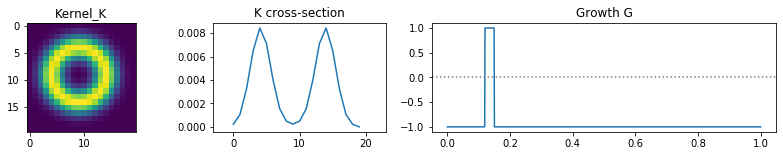

In [28]:
## SMOOTH KERNEL

"""Bell-shaped gaussian function. 

Lamba defines function parameters which are transformed by the function given 
after the colon. 

The function below outputs a point along the gaussian curve according to the mean and sd"""

bell = lambda x, m, s: np.exp(-((x-m)/s)**2/2)

# Set values
T = 10
size=64
R = 10
np.random.seed(0)
A = np.random.rand(size, size)

# Create Kernel
"""np.ogrid creates an empty grid space with x and y values of -R to R
(Ie. the full kernel space). This takes the shape of a [2, ] array. Each with values [-10:10].

np.linalg.norm then returns a Euclidean distance matrix with the Euclidean dist 
between each point. """
D = np.linalg.norm(np.asarray(np.ogrid[-R:R, -R:R]) + 1)/R

"""Each distance within one point of the center is transformed along gaussian curve.
Such that values closest to the edges are awarded proprotionally small values and vice
a versa. The result produces a smooth ring kernel"""

K = (D<1) * bell(D, 0.5, 0.15) ## All distances within radius 1, transformed along gaussian gradient
K = K/np.sum(K)  # Normalise

# GROWTH AND UPDATE FUNCTIONS ARE THE SAME
figure_asset(K, growth)
fig = figure_world(A)
IPython.display.HTML(matplotlib.animation.FuncAnimation(fig, update, frames=200, interval=20).to_jshtml())

See smooth gradient of the Kernel, as well as smooth ascent and descent in the cross section as values approach the center of the kernel matrix at 10. 

### Smooth Growth
Lastly, we can make the growth function completely smooth as well by using gaussian curve to define growth and shrinkage rates as well. This makes output patterns even smoother. 

Below we define growth using a bell-shaped curve with parameters $\mu$ (growth center) and $\sigma$ (growth width).

With everything smoothed, the system is finally arrived at Lenia (meaning "smooth" in Latin)

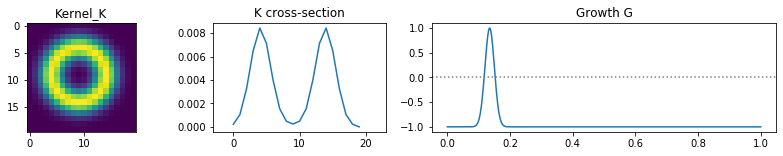

In [29]:
A = np.random.rand(size, size)  # Re-set A


def growth(U):
    """Smooth growth function"""
    #return 0 + ((U>=0.12)&(U<=0.15)) - ((U<0.12)|(U>0.15))
    m = 0.135
    s = 0.015
    return bell(U, m, s)*2-1


# Besides that Update and everything stays the same
figure_asset(K, growth)
fig = figure_world(A)
IPython.display.HTML(matplotlib.animation.FuncAnimation(fig, update, frames=200, interval=20).to_jshtml())

See now in figure (3) above, growth is also defined by a smooth Gaussian curve. 

## Summary
In summary the making of Lenia:

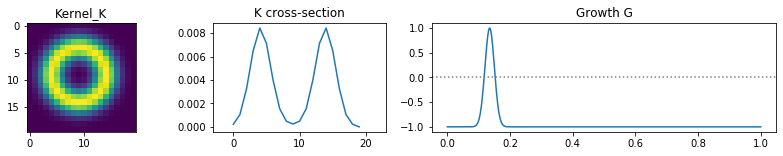

In [30]:
################## GOL TO LENIA ###################

### SET VALUES ###
size = 64

## CONTINUOUS STATES ##
# A = np.random.randint(2, size=(size, size)) # Grid initiated with 0,1 integers
A = np.random.rand(size, size)  # Grid initiated with any values between [0:1]

## SMOOTH RING KERNEL ##
# K = np.ones((3,3))  # Moore neighbourhood
R = 10  # Enlarge Kernel to radius 10
D = np.linalg.norm(np.asarray(np.ogrid[-R:R, -R:R]) + 1)/R  # create distance matrix
K = (D<1) * bell(D, 0.5, 0.15) ## Transform all distances within radius 1 along smooth gaussian gradient
K = K/np.sum(K)  # Normalise between 0:1

## INCREMENTAL SMOOTH GROWTH ##
T = 10

# Simple evaution of A according to U replaced with smooth growth function

# Define m and s for growth
m = 0.135
s = 0.015
def growth(U):
    """Smooth growth function"""
    #  return 0 + ((U>=0.12)&(U<=0.15)) - ((U<0.12)|(U>0.15))
    return bell(U, m, s)*2-1

# Each timestep takes 1/T increments of growth and adds to A, then clipped between 0 and 1
def update(i):
    global A, img
    U = convolve2d(A, K, mode='same', boundary='wrap')
    A = np.clip(A + 1/T * growth(U), 0, 1)
    img.set_array(A)
    return img,

figure_asset(K, growth)
fig = figure_world(A)
IPython.display.HTML(matplotlib.animation.FuncAnimation(fig, update, frames=200, interval=20).to_jshtml())

# Creatures in Lenia 

TypeError: growth() missing 2 required positional arguments: 'm' and 's'

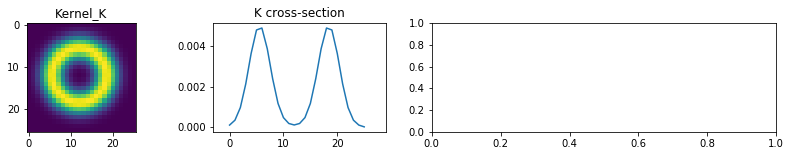

In [47]:
## ORBIUM 
pattern = {}
pattern["orbium"] = {"name":"Orbium","R":13,"T":10,"m":0.15,"s":0.015,"b":[1],
  "cells":[[0,0,0,0,0,0,0.1,0.14,0.1,0,0,0.03,0.03,0,0,0.3,0,0,0,0], [0,0,0,0,0,0.08,0.24,0.3,0.3,0.18,0.14,0.15,0.16,0.15,0.09,0.2,0,0,0,0], [0,0,0,0,0,0.15,0.34,0.44,0.46,0.38,0.18,0.14,0.11,0.13,0.19,0.18,0.45,0,0,0], [0,0,0,0,0.06,0.13,0.39,0.5,0.5,0.37,0.06,0,0,0,0.02,0.16,0.68,0,0,0], [0,0,0,0.11,0.17,0.17,0.33,0.4,0.38,0.28,0.14,0,0,0,0,0,0.18,0.42,0,0], [0,0,0.09,0.18,0.13,0.06,0.08,0.26,0.32,0.32,0.27,0,0,0,0,0,0,0.82,0,0], [0.27,0,0.16,0.12,0,0,0,0.25,0.38,0.44,0.45,0.34,0,0,0,0,0,0.22,0.17,0], [0,0.07,0.2,0.02,0,0,0,0.31,0.48,0.57,0.6,0.57,0,0,0,0,0,0,0.49,0], [0,0.59,0.19,0,0,0,0,0.2,0.57,0.69,0.76,0.76,0.49,0,0,0,0,0,0.36,0], [0,0.58,0.19,0,0,0,0,0,0.67,0.83,0.9,0.92,0.87,0.12,0,0,0,0,0.22,0.07], [0,0,0.46,0,0,0,0,0,0.7,0.93,1,1,1,0.61,0,0,0,0,0.18,0.11], [0,0,0.82,0,0,0,0,0,0.47,1,1,0.98,1,0.96,0.27,0,0,0,0.19,0.1], [0,0,0.46,0,0,0,0,0,0.25,1,1,0.84,0.92,0.97,0.54,0.14,0.04,0.1,0.21,0.05], [0,0,0,0.4,0,0,0,0,0.09,0.8,1,0.82,0.8,0.85,0.63,0.31,0.18,0.19,0.2,0.01], [0,0,0,0.36,0.1,0,0,0,0.05,0.54,0.86,0.79,0.74,0.72,0.6,0.39,0.28,0.24,0.13,0], [0,0,0,0.01,0.3,0.07,0,0,0.08,0.36,0.64,0.7,0.64,0.6,0.51,0.39,0.29,0.19,0.04,0], [0,0,0,0,0.1,0.24,0.14,0.1,0.15,0.29,0.45,0.53,0.52,0.46,0.4,0.31,0.21,0.08,0,0], [0,0,0,0,0,0.08,0.21,0.21,0.22,0.29,0.36,0.39,0.37,0.33,0.26,0.18,0.09,0,0,0], [0,0,0,0,0,0,0.03,0.13,0.19,0.22,0.24,0.24,0.23,0.18,0.13,0.05,0,0,0,0], [0,0,0,0,0,0,0,0,0.02,0.06,0.08,0.09,0.07,0.05,0.01,0,0,0,0,0]]
}

scale = 1  # scaling factor- can be changed to make larger or smaller
cx, cy = 20, 20  # Initial position - can also be changed
size = 100

"""Load pattern above- gives all parameters R, T, m, s and cells"""
globals().update(pattern["orbium"]); C = np.asarray(cells)
R = R*scale  # scale R

C = sc.ndimage.zoom(C, scale, order=0)  # Scale cells according to given value

"""Create initial configurations"""
A = np.zeros([size, size])
A[cx:cx+C.shape[0], cy:cy+C.shape[1]] = C  # Place the scaled pattern on grid

"""Create Kernel"""
D = np.linalg.norm(np.asarray(np.ogrid[-R:R, -R:R]) + 1) / R
K = (D<1) * bell(D, 0.5, 0.15)
K = K / np.sum(K)

# GROWTH AND UPDATE DEFINED ABOVE
figure_asset(K, growth)
fig = figure_world(A)
IPython.display.HTML(matplotlib.animation.FuncAnimation(fig, update, frames=200, interval=20).to_jshtml())

In [35]:
# ADD ANOTHER 
A = np.zeros([size, size])
A[cx:cx+C.shape[0], cy:cy+C.shape[1]] = C  # Place the scaled pattern on grid
A[50:70, 20:40] = np.flip(C)

fig = figure_world(A)
IPython.display.HTML(matplotlib.animation.FuncAnimation(fig, update, frames=200, interval=20).to_jshtml())

In [36]:
# ADD SOME NOISE
A = np.zeros([size, size])
A[cx:cx+C.shape[0], cy:cy+C.shape[1]] = C  # Place the scaled pattern on grid
A[50:70, 20:40] = np.flip(C)
A = A + (np.random.rand(size,size)/5)  # noise


fig = figure_world(A)
IPython.display.HTML(matplotlib.animation.FuncAnimation(fig, update, frames=200, interval=20).to_jshtml())

## Fourier Transformation
Fourier transformations (fft) can be used instead of convolution calculations to make calculations more efficient. 

ValueError: operands could not be broadcast together with shapes (64,64) (100,100) 

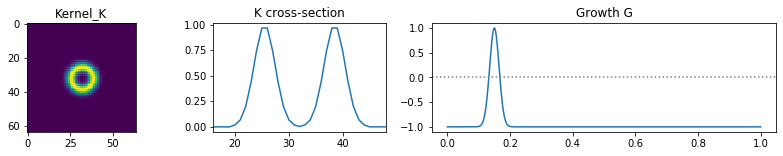

In [38]:
## USE FOURIER INSTEAD OF NAIVE CONVOLUTION

# Re-set grid (still using orbium parameters)
A = np.zeros([size, size])
C = sc.ndimage.zoom(C, scale, order=0);  R *= scale
A[cx:cx+C.shape[0], cy:cy+C.shape[1]] = C

"""To use FFT, the kernel and world must be the same size"""
size = 64; mid = size//2; scale = 1; cx, cy = 20, 20

D = np.linalg.norm(np.ogrid[-mid:mid, -mid:mid]) / R
K = (D<1) * bell(D, 0.5, 0.15)

"""Pre-calculate FFT of the kernel"""
fK = np.fft.fft2(np.fft.fftshift(K/np.sum(K)))

# GROWTH STAYS THE SAME

def update(i):
    global A, img
    """Use FFT to perform convolution:
    Inverse fourier transform the multiplication of fourier transformed Kernel and A"""
    U = np.real(np.fft.ifft2(fK*np.fft.fft2(A)))
    A = np.clip(A + 1/T * growth(U), 0, 1)
    img.set_array(A)
    return img,

figure_asset(K, growth)
fig = figure_world(A)
IPython.display.HTML(matplotlib.animation.FuncAnimation(fig, update, frames=200, interval=20).to_jshtml())

## Multi-ring Kernel
Extend the kernel into multiple rings, with a new parameter, Kernel Peaks $\beta$

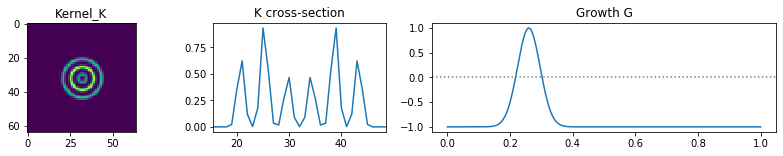

In [39]:
## LOAD hydrogeminium pattern
pattern["geminium"] = {"name":"Hydrogeminium","R":18,"T":10,"m":0.26,"s":0.036,"b":[0.5,1,0.667],
  "cells":[[0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.01,0.02,0.03,0.04,0.04,0.04,0.03,0.02,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.04,0.1,0.16,0.2,0.23,0.25,0.24,0.21,0.18,0.14,0.1,0.07,0.03,0,0,0,0,0,0,0], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.01,0.09,0.2,0.33,0.44,0.52,0.56,0.58,0.55,0.51,0.44,0.37,0.3,0.23,0.16,0.08,0.01,0,0,0,0,0], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.13,0.29,0.45,0.6,0.75,0.85,0.9,0.91,0.88,0.82,0.74,0.64,0.55,0.46,0.36,0.25,0.12,0.03,0,0,0,0], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.14,0.38,0.6,0.78,0.93,1.0,1.0,1.0,1.0,1.0,1.0,0.99,0.89,0.78,0.67,0.56,0.44,0.3,0.15,0.04,0,0,0], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.08,0.39,0.74,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.98,0.85,0.74,0.62,0.47,0.3,0.14,0.03,0,0], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.32,0.76,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.88,0.75,0.61,0.45,0.27,0.11,0.01,0], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.35,0.83,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.88,0.73,0.57,0.38,0.19,0.05,0], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.5,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.99,1.0,1.0,1.0,1.0,0.99,1.0,1.0,1.0,1.0,1.0,1.0,0.85,0.67,0.47,0.27,0.11,0.01], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.55,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.93,0.83,0.79,0.84,0.88,0.89,0.9,0.93,0.98,1.0,1.0,1.0,1.0,0.98,0.79,0.57,0.34,0.15,0.03], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.47,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.9,0.72,0.54,0.44,0.48,0.6,0.7,0.76,0.82,0.91,0.99,1.0,1.0,1.0,1.0,0.91,0.67,0.41,0.19,0.05], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.27,0.99,1.0,1.0,1.0,1.0,0.9,0.71,0.65,0.55,0.38,0.2,0.14,0.21,0.36,0.52,0.64,0.73,0.84,0.95,1.0,1.0,1.0,1.0,1.0,0.78,0.49,0.24,0.07], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.14,0.63,0.96,1.0,1.0,1.0,0.84,0.17,0,0,0,0,0,0,0,0.13,0.35,0.51,0.64,0.77,0.91,0.99,1.0,1.0,1.0,1.0,0.88,0.58,0.29,0.09], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.07,0.38,0.72,0.95,1.0,1.0,1.0,0.22,0,0,0,0,0,0,0,0,0,0.11,0.33,0.5,0.67,0.86,0.99,1.0,1.0,1.0,1.0,0.95,0.64,0.33,0.1], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.32,0.49,0.71,0.93,1.0,1.0,1.0,0.56,0,0,0,0,0,0,0,0,0,0,0,0.1,0.31,0.52,0.79,0.98,1.0,1.0,1.0,1.0,0.98,0.67,0.35,0.11], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.01,0.6,0.83,0.98,1.0,1.0,0.68,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.15,0.38,0.71,0.97,1.0,1.0,1.0,1.0,0.97,0.67,0.35,0.11], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.51,0.96,1.0,1.0,0.18,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.09,0.34,0.68,0.95,1.0,1.0,1.0,1.0,0.91,0.61,0.32,0.1], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.13,0.56,0.99,1.0,1.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.17,0.45,0.76,0.96,1.0,1.0,1.0,1.0,0.82,0.52,0.26,0.07], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.33,0.7,0.94,1.0,1.0,0.44,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.33,0.68,0.91,0.99,1.0,1.0,1.0,1.0,0.71,0.42,0.19,0.03], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.53,0.89,1.0,1.0,1.0,0.8,0.43,0.04,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.47,0.86,1.0,1.0,1.0,1.0,1.0,0.95,0.58,0.32,0.12,0], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.77,0.99,1.0,0.97,0.58,0.41,0.33,0.18,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.54,0.95,1.0,1.0,1.0,1.0,1.0,0.8,0.44,0.21,0.06,0], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.39,0.83,1.0,1.0,0.55,0.11,0.05,0.15,0.22,0.06,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.58,0.99,1.0,1.0,1.0,1.0,1.0,0.59,0.29,0.11,0.01,0], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.04,0.55,0.81,0.86,0.97,1.0,1.0,0.5,0,0,0.01,0.09,0.03,0,0,0,0,0,0,0,0,0,0,0,0,0,0.26,0.78,1.0,1.0,1.0,1.0,1.0,0.66,0.35,0.13,0.03,0,0], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.33,1.0,1.0,1.0,1.0,1.0,1.0,0.93,0.11,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.23,0.73,0.95,1.0,1.0,1.0,1.0,1.0,0.62,0.35,0.12,0,0,0,0], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.51,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.72,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.56,0.25,0.09,0,0,0,0,0], [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.12,0.38,1.0,1.0,1.0,0.66,0.08,0.55,1.0,1.0,1.0,0.03,0,0,0,0,0,0,0,0,0,0,0,0,0,0.35,1.0,1.0,1.0,1.0,1.0,1.0,0.67,0.12,0,0,0,0,0,0,0], [0,0,0,0,0,0,0,0,0,0,0,0,0.6,1.0,1.0,1.0,1.0,1.0,1.0,0.49,0,0,0.87,1.0,0.88,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1.0,1.0,1.0,1.0,1.0,1.0,0.7,0.07,0,0,0,0,0,0,0,0], [0,0,0,0,0,0,0,0,0,0.04,0.21,0.48,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0,0,0.04,0.42,0.26,0,0,0,0,0,0,0,0,0,0.12,0.21,0.34,0.58,1.0,1.0,1.0,0.99,0.97,0.99,0.46,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0,0,0,0,0,0.5,1.0,1.0,1.0,1.0,0.96,0,0.31,1.0,1.0,1.0,0.53,0,0,0,0,0,0,0,0,0.2,0.21,0,0,0,0.27,1.0,1.0,1.0,1.0,1.0,1.0,0.87,0.52,0.01,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0,0,0,0,0.84,1.0,1.0,1.0,1.0,1.0,0,0,0,0.83,1.0,1.0,0.52,0,0,0,0,0,0,0,0.26,0.82,0.59,0.02,0,0,0.46,1.0,1.0,1.0,1.0,1.0,0.9,0.55,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0,0,0,0.39,0.99,1.0,1.0,1.0,1.0,0.78,0.04,0,0,0,0.93,0.92,0,0,0,0,0,0,0,0,0.69,1.0,1.0,0.36,0,0,1.0,1.0,0.65,0.66,0.97,0.87,0.54,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0.55,0.75,0.59,0.74,1.0,1.0,0,0,0.75,0.71,0.18,0,0,0,0,0,0,0,0,0,0,0.29,0,0,0.45,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.47,0.39,0.71,0.25,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0.69,0.81,0.8,0.92,1.0,0.13,0,0,0.13,0.94,0.58,0,0,0,0,0,0,0,0,0,1.0,1.0,0.34,0,0.04,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.24,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0.63,0.85,0.9,0.98,1.0,0.09,0,0,0.02,1.0,0.64,0,0,0,0,0,0,0,0,0.59,1.0,1.0,0.84,0,0,1.0,1.0,1.0,1.0,1.0,1.0,0.64,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0.64,0.65,0.67,1.0,1.0,0.21,0.01,0,0.04,0.02,0,0,0,0,0,0,0,0,0,0.69,1.0,1.0,1.0,0.29,0.37,1.0,1.0,0.6,0.63,1.0,0.84,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0.44,0.73,0.73,0.85,1.0,0.97,0.23,0.05,0,0,0,0,0,0,0,0,0.06,0,0,0,0.97,1.0,1.0,1.0,1.0,1.0,1.0,0.33,0.24,0.67,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0.12,0.55,0.9,0.9,1.0,1.0,1.0,0.43,0.04,0,0,0,0,0,0,0,0.31,0.54,0,0,0,0.88,1.0,1.0,1.0,1.0,1.0,1.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0.29,0.71,1.0,1.0,1.0,1.0,0.79,0.28,0,0,0,0,0,0,0,0,0.4,0.77,0.54,0,0,0.87,1.0,1.0,1.0,1.0,1.0,0.31,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0.16,0.27,0.41,0.72,0.99,1.0,1.0,0.82,0.42,0.09,0,0,0,0,0,0,0,0,0.1,0.55,0.58,0.58,0.77,0.99,1.0,1.0,1.0,1.0,0.63,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0.31,0.48,0.45,0.46,0.63,0.88,1.0,0.83,0.59,0.28,0.06,0,0,0,0,0,0,0,0,0,0.32,0.7,0.95,1.0,1.0,1.0,1.0,0.7,0.58,0.12,0.04,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0.23,0.54,0.53,0.48,0.57,0.59,0.65,0.63,0.55,0.35,0.13,0.03,0.02,0.09,0.74,1.0,0.09,0,0,0,0.32,0.86,1.0,1.0,1.0,1.0,0.57,0.44,0.31,0.16,0.01,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0.31,0.45,0.31,0.18,0.28,0.39,0.47,0.54,0.5,0.35,0.2,0.16,0.28,0.75,1.0,0.42,0.01,0,0,0.6,1.0,1.0,1.0,1.0,0.51,0.29,0.09,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0,0.14,0.3,0.4,0.54,0.71,0.74,0.65,0.49,0.35,0.27,0.47,0.6,0.6,0.72,0.98,1.0,1.0,1.0,1.0,0.65,0.33,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0,0.06,0.33,0.53,0.69,0.94,0.99,1.0,0.84,0.41,0.16,0.15,0.96,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.73,0.13,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0,0,0.42,0.86,0.98,0.98,0.99,1.0,0.94,0.63,0.32,0.62,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.65,0.23,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0,0.07,0.62,0.95,1.0,1.0,0.99,0.98,0.99,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.98,0.14,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0,0.03,0.46,0.89,1.0,1.0,0.97,0.83,0.75,0.81,0.94,1.0,1.0,1.0,1.0,0.99,0.03,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0,0,0.14,0.57,0.88,0.93,0.81,0.58,0.45,0.48,0.64,0.86,0.97,0.99,0.99,0.42,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0,0,0,0,0.23,0.45,0.47,0.39,0.29,0.19,0.2,0.46,0.28,0.03,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0,0,0,0,0,0,0.08,0.22,0.24,0.15,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0], [0,0,0,0,0,0,0,0,0,0,0,0.07,0.22,0.14,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0]]
}
size = 64;  mid = size // 2;  scale = 0.75;  cx, cy = 10, 10
globals().update(pattern["geminium"]); b = np.asarray(b); C = np.asarray(cells)
A = np.zeros([size, size])

C = sc.ndimage.zoom(C, scale, order=0); R *= scale
A[cx:cx+C.shape[0], cy:cy+C.shape[1]] = C  # Initiate cells for geminium

"""Multiple ring kernel:
Distance matrix D normalised by radius and multiplied by number of rings len(b)

This makes pattern repeat itself over three times. It is them moduloed by
1 rendering 3 discrete rings."""
D = np.linalg.norm(np.ogrid[-mid:mid, -mid:mid]) / R * len(b)  # Multiply by kernel peaks
K = (D<len(b)) * b[np.minimum(D.astype(int), len(b)-1)] * bell(D%1, 0.5, 0.15)  # Divide by kernel peaks to get three rings
fk = np.fft.fft2(np.fft.fftshift(K/np.sum(K)))

def growth(U):
    return bell(U, m, s)*2-1

def update(i):
    global A, img
    U = np.real(np.fft.ifft2(fk*np.fft.fft2(A)))
    A = np.clip(A + 1/T * growth(U), 0, 1)
    img.set_array(A)
    return img,

figure_asset(K, growth)
fig = figure_world(A)

IPython.display.HTML(matplotlib.animation.FuncAnimation(fig, update, frames=200, interval=20).to_jshtml())

## Multiple Kernels

In [40]:
# MODEL MULTIPLE KERNELS IN LENIA

# Load fish pattern for multiple kernels
pattern = {}
pattern["fish"] = {"name": "K=3 Fish", "R": 10, "T": 5, "kernels": [
    {"b": [1, 5 / 12, 2 / 3], "m": 0.156, "s": 0.0118, "h": 1, "c0": 0, "c1": 0},
    {"b": [1 / 12, 1], "m": 0.193, "s": 0.049, "h": 1, "c0": 0, "c1": 0},
    {"b": [1], "m": 0.342, "s": 0.0891, "h": 1, "c0": 0, "c1": 0}],
                   "cells": [[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0.06, 0.1, 0.04, 0.02, 0.01, 0, 0, 0, 0, 0, 0],
                             [0, 0, 0, 0, 0, 0, 0, 0, 0.15, 0.37, 0.5, 0.44, 0.19, 0.23, 0.3, 0.23, 0.15, 0.01, 0, 0, 0,
                              0], [0, 0, 0, 0, 0, 0, 0.32, 0.78, 0.26, 0, 0.11, 0.11, 0.1, 0.08, 0.18, 0.16, 0.17, 0.24,
                                   0.09, 0, 0, 0],
                             [0, 0, 0, 0, 0.45, 0.16, 0, 0, 0, 0, 0, 0.15, 0.15, 0.16, 0.15, 0.1, 0.09, 0.21, 0.24,
                              0.12, 0, 0],
                             [0, 0, 0, 0.1, 0, 0, 0, 0, 0, 0, 0, 0.17, 0.39, 0.43, 0.34, 0.25, 0.15, 0.16, 0.15, 0.25,
                              0.03, 0],
                             [0, 0.15, 0.06, 0, 0, 0, 0, 0, 0, 0, 0.24, 0.72, 0.92, 0.85, 0.61, 0.47, 0.39, 0.27, 0.12,
                              0.18, 0.17, 0],
                             [0, 0.08, 0, 0, 0, 0, 0, 0, 0, 0, 1.0, 1.0, 1.0, 1.0, 0.73, 0.6, 0.56, 0.31, 0.12, 0.15,
                              0.24, 0.01],
                             [0, 0.16, 0, 0, 0, 0, 0, 0, 0, 0.76, 1.0, 1.0, 1.0, 1.0, 0.76, 0.72, 0.65, 0.39, 0.1, 0.17,
                              0.24, 0.05],
                             [0, 0.05, 0, 0, 0, 0, 0, 0, 0.21, 0.83, 1.0, 1.0, 1.0, 1.0, 0.86, 0.85, 0.76, 0.36, 0.17,
                              0.13, 0.21, 0.07],
                             [0, 0.05, 0, 0, 0.02, 0, 0, 0, 0.4, 0.91, 1.0, 1.0, 1.0, 1.0, 1.0, 0.95, 0.79, 0.36, 0.21,
                              0.09, 0.18, 0.04],
                             [0.06, 0.08, 0, 0.18, 0.21, 0.1, 0.03, 0.38, 0.92, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.64,
                              0.31, 0.12, 0.07, 0.25, 0],
                             [0.05, 0.12, 0.27, 0.4, 0.34, 0.42, 0.93, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.97,
                              0.33, 0.16, 0.05, 0.1, 0.26, 0],
                             [0, 0.25, 0.21, 0.39, 0.99, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.86, 0.89, 0.94, 0.83, 0.13, 0,
                              0, 0.04, 0.21, 0.18, 0],
                             [0, 0.06, 0.29, 0.63, 0.84, 0.97, 1.0, 1.0, 1.0, 0.96, 0.46, 0.33, 0.36, 0, 0, 0, 0, 0,
                              0.03, 0.35, 0, 0],
                             [0, 0, 0.13, 0.22, 0.59, 0.85, 0.99, 1.0, 0.98, 0.25, 0, 0, 0, 0, 0, 0, 0, 0, 0.34, 0.14,
                              0, 0],
                             [0, 0, 0, 0, 0.33, 0.7, 0.95, 0.8, 0.33, 0.11, 0, 0, 0, 0, 0, 0, 0, 0.11, 0.26, 0, 0, 0],
                             [0, 0, 0, 0, 0.16, 0.56, 0.52, 0.51, 0.4, 0.18, 0.01, 0, 0, 0, 0, 0, 0, 0.42, 0, 0, 0, 0],
                             [0, 0, 0, 0, 0.01, 0, 0.33, 0.47, 0.33, 0.05, 0, 0, 0, 0, 0, 0, 0.35, 0, 0, 0, 0, 0],
                             [0, 0, 0, 0, 0, 0.26, 0.32, 0.13, 0, 0, 0, 0, 0, 0, 0, 0.34, 0, 0, 0, 0, 0, 0],
                             [0, 0, 0, 0, 0, 0.22, 0.25, 0.03, 0, 0, 0, 0, 0, 0, 0.46, 0, 0, 0, 0, 0, 0, 0],
                             [0, 0, 0, 0, 0, 0, 0.09, 0.2, 0.22, 0.23, 0.23, 0.22, 0.3, 0.3, 0, 0, 0, 0, 0, 0, 0, 0]]
                   }


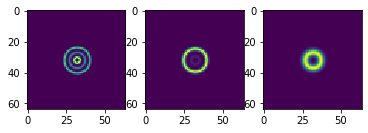

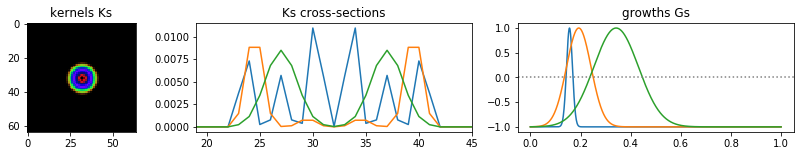

In [42]:
# SET VALUES
bell = lambda x, m, s: np.exp(-((x - m) / s) ** 2 / 2)  # Gaussian function
size = 64;
mid = size // 2;
scale = 1;
cx, cy = 20, 20
globals().update(pattern["fish"]);
C = np.asarray(cells)  # Load initial configuration of cells

A = np.zeros([size, size])
C = sc.ndimage.zoom(C, scale, order=0) # scale initial config of cells if scale is specified
R *= scale  # scale radius of kernel
A[cx:cx+C.shape[0], cy:cy+C.shape[1]] = C  # Load initial configuration onto grid

"""Prepare multiple kernels using list comprehension"""
# Get distance matrix for each kernel
Ds = [np.linalg.norm(np.ogrid[-mid:mid, -mid:mid])/R*len(k["b"]) for k in kernels]

"""Kernels given by: for each Distance matrix, each cell within length b, multiplied by 
smallest distance in D, or lengthb minus 2 (whichever is smallest) times bell distribution"""
Ks = [(D <len(k["b"])) * np.asarray(k["b"])[np.minimum(D.astype(int), len(k["b"])-1)] * 
      bell(D % 1, 0.5, 0.15) for D, k in zip (Ds, kernels)]

nKs = [ k/np.sum(k) for k in Ks]  # normalise each kernel in Ks
fKs = [ np.fft.fft2(np.fft.fftshift(k)) for k in nKs]  # fourier transform each K

def growth(U, m, s):
    return bell(U, m, s)*2-1

def update(i):
    global A, img
    """Use multiple kernels to calculate average growth"""
    Us = [ np.real(np.fft.ifft2(fk*np.fft.fft2(A))) for fk in fKs]
    Gs = [ growth(U, k["m"], k["s"]) for U, k in zip(Us, kernels)]  # Calculate growth for each K
    
    A = np.clip(A + 1/T*np.mean(np.asarray(Gs), axis=0), 0, 1) # Average growth distributions and add to grid
    img.set_array(A)
    return img,

# Check out inidivudal kernels 
b_list = [ k["b"] for k in kernels]
fig, ax = plt.subplots(1, 3)
ax[0].imshow(Ks[0])
ax[1].imshow(Ks[1])
ax[2].imshow(Ks[2])
plt.show()

# All kernels together
figure_asset_list(Ks, nKs, growth, kernels)
plt.show()

fig = figure_world(A)
IPython.display.HTML(matplotlib.animation.FuncAnimation(fig, update, frames=200, interval=20).to_jshtml())

## Multiple Channels

In [43]:
## Pattern below describes 15 kernels, each one associates with a target cell
pattern["aquarium"] = {"name": "Tessellatium gyrans", "R": 12, "T": 2, "kernels": [
    {"b": [1], "m": 0.272, "s": 0.0595, "h": 0.138, "r": 0.91, "c0": 0, "c1": 0},
    {"b": [1], "m": 0.349, "s": 0.1585, "h": 0.48, "r": 0.62, "c0": 0, "c1": 0},
    {"b": [1, 1 / 4], "m": 0.2, "s": 0.0332, "h": 0.284, "r": 0.5, "c0": 0, "c1": 0},
    {"b": [0, 1], "m": 0.114, "s": 0.0528, "h": 0.256, "r": 0.97, "c0": 1, "c1": 1},
    {"b": [1], "m": 0.447, "s": 0.0777, "h": 0.5, "r": 0.72, "c0": 1, "c1": 1},
    {"b": [5 / 6, 1], "m": 0.247, "s": 0.0342, "h": 0.622, "r": 0.8, "c0": 1, "c1": 1},
    {"b": [1], "m": 0.21, "s": 0.0617, "h": 0.35, "r": 0.96, "c0": 2, "c1": 2},
    {"b": [1], "m": 0.462, "s": 0.1192, "h": 0.218, "r": 0.56, "c0": 2, "c1": 2},
    {"b": [1], "m": 0.446, "s": 0.1793, "h": 0.556, "r": 0.78, "c0": 2, "c1": 2},
    {"b": [11 / 12, 1], "m": 0.327, "s": 0.1408, "h": 0.344, "r": 0.79, "c0": 0, "c1": 1},
    {"b": [3 / 4, 1], "m": 0.476, "s": 0.0995, "h": 0.456, "r": 0.5, "c0": 0, "c1": 2},
    {"b": [11 / 12, 1], "m": 0.379, "s": 0.0697, "h": 0.67, "r": 0.72, "c0": 1, "c1": 0},
    {"b": [1], "m": 0.262, "s": 0.0877, "h": 0.42, "r": 0.68, "c0": 1, "c1": 2},
    {"b": [1 / 6, 1, 0], "m": 0.412, "s": 0.1101, "h": 0.43, "r": 0.82, "c0": 2, "c1": 0},
    {"b": [1], "m": 0.201, "s": 0.0786, "h": 0.278, "r": 0.82, "c0": 2, "c1": 1}],
                       "cells": [
                           [[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0.04, 0, 0, 0, 0, 0, 0, 0, 0, 0],
                            [0, 0, 0, 0, 0, 0, 0, 0, 0, 0.49, 1.0, 0, 0.03, 0.49, 0.49, 0.28, 0.16, 0.03, 0, 0, 0, 0, 0,
                             0],
                            [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0.6, 0.47, 0.31, 0.58, 0.51, 0.35, 0.28, 0.22, 0, 0, 0, 0,
                             0],
                            [0, 0, 0, 0, 0, 0, 0.15, 0.32, 0.17, 0.61, 0.97, 0.29, 0.67, 0.59, 0.88, 1.0, 0.92, 0.8,
                             0.61, 0.42, 0.19, 0, 0, 0],
                            [0, 0, 0, 0, 0, 0, 0, 0.25, 0.64, 0.26, 0.92, 0.04, 0.24, 0.97, 1.0, 1.0, 1.0, 1.0, 0.97,
                             0.71, 0.33, 0.12, 0, 0],
                            [0, 0, 0, 0, 0, 0, 0, 0.38, 0.84, 0.99, 0.78, 0.67, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.95,
                             0.62, 0.37, 0, 0],
                            [0, 0, 0, 0, 0.04, 0.11, 0, 0.69, 0.75, 0.75, 0.91, 1.0, 1.0, 0.89, 1.0, 1.0, 1.0, 1.0, 1.0,
                             1.0, 0.81, 0.42, 0.07, 0],
                            [0, 0, 0, 0, 0.44, 0.63, 0.04, 0, 0, 0, 0.11, 0.14, 0, 0.05, 0.64, 1.0, 1.0, 1.0, 1.0, 1.0,
                             0.92, 0.56, 0.23, 0],
                            [0, 0, 0, 0, 0.11, 0.36, 0.35, 0.2, 0, 0, 0, 0, 0, 0, 0.63, 1.0, 1.0, 1.0, 1.0, 1.0, 0.96,
                             0.49, 0.26, 0],
                            [0, 0, 0, 0, 0, 0.4, 0.37, 0.18, 0, 0, 0, 0, 0, 0.04, 0.41, 0.52, 0.67, 0.82, 1.0, 1.0,
                             0.91, 0.4, 0.23, 0],
                            [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0.04, 0, 0.05, 0.45, 0.89, 1.0, 0.66, 0.35, 0.09,
                             0],
                            [0, 0, 0.22, 0, 0, 0, 0.05, 0.36, 0.6, 0.13, 0.02, 0.04, 0.24, 0.34, 0.1, 0, 0.04, 0.62,
                             1.0, 1.0, 0.44, 0.25, 0, 0],
                            [0, 0, 0, 0.43, 0.53, 0.58, 0.78, 0.9, 0.96, 1.0, 1.0, 1.0, 1.0, 0.71, 0.46, 0.51, 0.81,
                             1.0, 1.0, 0.93, 0.19, 0.06, 0, 0],
                            [0, 0, 0, 0, 0.23, 0.26, 0.37, 0.51, 0.71, 0.89, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0,
                             1.0, 0.42, 0.06, 0, 0, 0],
                            [0, 0, 0, 0, 0.03, 0, 0, 0.11, 0.35, 0.62, 0.81, 0.93, 1.0, 1.0, 1.0, 1.0, 1.0, 0.64, 0.15,
                             0, 0, 0, 0, 0],
                            [0, 0, 0, 0, 0, 0, 0.06, 0.1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
                            [0, 0, 0, 0, 0, 0, 0, 0.05, 0.09, 0.05, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
                            [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]],
                           [[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
                            [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
                            [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0.02, 0.28, 0.42, 0.44, 0.34, 0.18, 0, 0, 0],
                            [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0.34, 1.0, 1.0, 1.0, 1.0, 1.0, 0.91, 0.52, 0.14,
                             0],
                            [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0.01, 0.17, 0.75, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.93,
                             0.35, 0],
                            [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0.22, 0.92, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.59,
                             0.09],
                            [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0.75, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.71,
                             0.16],
                            [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0.01, 0.67, 0.83, 0.85, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0,
                             0.68, 0.17],
                            [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0.21, 0.04, 0.12, 0.58, 0.95, 1.0, 1.0, 1.0, 1.0, 1.0,
                             0.57, 0.13],
                            [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0.07, 0, 0, 0, 0.2, 0.64, 0.96, 1.0, 1.0, 1.0, 0.9, 0.24,
                             0.01],
                            [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0.13, 0.29, 0, 0, 0, 0.25, 0.9, 1.0, 1.0, 1.0, 1.0, 0.45,
                             0.05, 0],
                            [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0.13, 0.31, 0.07, 0, 0.46, 0.96, 1.0, 1.0, 1.0, 1.0, 0.51,
                             0.12, 0, 0],
                            [0, 0, 0, 0, 0, 0, 0, 0, 0.26, 0.82, 1.0, 0.95, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.3,
                             0.05, 0, 0, 0],
                            [0, 0, 0, 0, 0, 0, 0, 0, 0.28, 0.74, 1.0, 0.95, 0.87, 1.0, 1.0, 1.0, 1.0, 1.0, 0, 0, 0, 0,
                             0, 0],
                            [0, 0, 0, 0, 0, 0, 0, 0, 0.07, 0.69, 1.0, 1.0, 1.0, 1.0, 1.0, 0.96, 0.25, 0, 0, 0, 0, 0, 0,
                             0],
                            [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0.4, 0.72, 0.9, 0.83, 0.7, 0.56, 0.43, 0.14, 0, 0, 0, 0, 0,
                             0], [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
                            [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]],
                           [[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
                            [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0.04, 0.25, 0.37, 0.44, 0.37, 0.24, 0.11, 0.04, 0, 0,
                             0, 0],
                            [0, 0, 0, 0, 0, 0, 0, 0, 0, 0.19, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.75, 0.4, 0.15, 0, 0,
                             0, 0],
                            [0, 0, 0, 0, 0, 0, 0, 0, 0.14, 0.48, 0.83, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.4, 0,
                             0, 0, 0],
                            [0, 0, 0, 0, 0, 0, 0, 0, 0.62, 0.78, 0.94, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.64, 0,
                             0, 0, 0],
                            [0, 0, 0, 0, 0, 0, 0, 0.02, 0.65, 0.98, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.78,
                             0, 0, 0, 0],
                            [0, 0, 0, 0, 0, 0, 0, 0.15, 0.48, 0.93, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.79,
                             0.05, 0, 0, 0],
                            [0, 0, 0, 0, 0, 0, 0.33, 0.56, 0.8, 1.0, 1.0, 1.0, 0.37, 0.6, 0.94, 1.0, 1.0, 1.0, 1.0,
                             0.68, 0.05, 0, 0, 0],
                            [0, 0, 0, 0, 0.35, 0.51, 0.76, 0.89, 1.0, 1.0, 0.72, 0.15, 0, 0.29, 0.57, 0.69, 0.86, 1.0,
                             0.92, 0.49, 0, 0, 0, 0],
                            [0, 0, 0, 0, 0, 0.38, 0.86, 1.0, 1.0, 0.96, 0.31, 0, 0, 0, 0, 0.02, 0.2, 0.52, 0.37, 0.11,
                             0, 0, 0, 0],
                            [0, 0, 0.01, 0, 0, 0.07, 0.75, 1.0, 1.0, 1.0, 0.48, 0.03, 0, 0, 0, 0, 0, 0.18, 0.07, 0, 0,
                             0, 0, 0],
                            [0, 0.11, 0.09, 0.22, 0.15, 0.32, 0.71, 0.94, 1.0, 1.0, 0.97, 0.54, 0.12, 0.02, 0, 0, 0, 0,
                             0, 0, 0, 0, 0, 0],
                            [0.06, 0.33, 0.47, 0.51, 0.58, 0.77, 0.95, 1.0, 1.0, 1.0, 1.0, 0.62, 0.12, 0, 0, 0, 0, 0, 0,
                             0, 0, 0, 0, 0],
                            [0.04, 0.4, 0.69, 0.88, 0.95, 1.0, 1.0, 1.0, 1.0, 1.0, 0.93, 0.68, 0.22, 0.02, 0, 0, 0.01,
                             0, 0, 0, 0, 0, 0, 0],
                            [0, 0.39, 0.69, 0.91, 1.0, 1.0, 1.0, 1.0, 1.0, 0.85, 0.52, 0.35, 0.24, 0.17, 0.07, 0, 0, 0,
                             0, 0, 0, 0, 0, 0],
                            [0, 0, 0.29, 0.82, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.67, 0.29, 0.02, 0, 0, 0, 0, 0, 0, 0, 0,
                             0, 0, 0],
                            [0, 0, 0, 0, 0.2, 0.51, 0.77, 0.96, 0.93, 0.71, 0.4, 0.16, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
                             0], [0, 0, 0, 0, 0, 0, 0, 0, 0.08, 0.07, 0.03, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]]]
                       }


/usr/lib/python3/dist-packages/scipy/ndimage/interpolation.py:608: UserWarning: From scipy 0.13.0, the output shape of zoom() is calculated with round() instead of int() - for these inputs the size of the returned array has changed.
  warnings.warn(


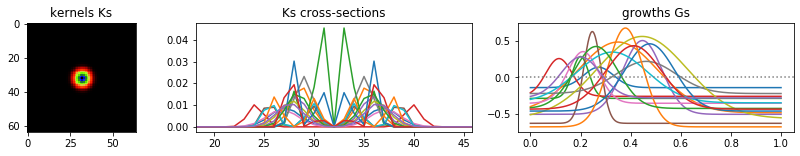

In [44]:
# MULTIPLE CHANNELS
"""Extend lenia with multiple channels. Introduce two new parameters, 
Relative kernel (r) and growth height (h).
- Growth height gives how much a given growth distribution impacts the final outcome

Each kernel+growth function coupel corresponds to one source channel (c0) which is scanned
for neighbourhood sum U, and one
target channel (c1) which it updates"""

bell = lambda x, m, s: np.exp(-((x - m) / s) ** 2 / 2)
size = 64;
mid = size // 2;
scale = 0.9;
cx, cy = 20, 20
globals().update(pattern["aquarium"])  # Load Tessellatium, a multi-channel creature

"""Place pattern into multiple channels """
As = [np.zeros([size, size]) for i in range(3)]  # Load three grids ("channels")
Cs = [sc.ndimage.zoom(np.asarray(c), scale, order=0) for c in cells]  # Scale all three sets of cells
R *= scale

for A, C in zip(As, Cs): A[cx:cx + C.shape[0], cy:cy + C.shape[1]] = C  # Load cells onto each grid in A

Ds = [np.linalg.norm(np.ogrid[-mid:mid, -mid:mid]) / R * len(k["b"]) / k["r"]
      for k in kernels]
Ks = [(D < len(k["b"])) * np.asarray(k["b"])[np.minimum(D.astype(int), len(k["b"]) - 1)] *
      bell(D % 1, 0.5, 0.15) for D, k in zip(Ds, kernels)]

nKs = [k / np.sum(k) for k in Ks]  # Normalise each Kernel
fKs = [np.fft.fft2(np.fft.fftshift(K)) for K in nKs]  # Fourier transform

def growth(U, m, s):
    return bell(U, m, s) * 2 - 1

def update(i):
    global As, img
    """Calculate convolution from source channels c0.
    Above kernel list contains C0, C1. Source channel and target channel. 
    Values are populated with [0, 1, 2]- corresponds to our three channels
    and says which channel is the source, and which is the target.
    
    Ie. Cells existing in a single channel can still be sensitive to cells
    in another channel via the source and target channels that their growth/kernel are 
    associated with.
    
    Each channel has five kernels/growth functions"""
    fAs = [np.fft.fft2(A) for A in As]  # Fourier transform each A
    Us = [np.real(np.fft.ifft2(fK * fAs[k["c0"]]))  # For each Kernel, convolve kernel by source channel in As
          for fK, k in zip(fKs, kernels)]
    """Calculate growth values for destination channels"""
    Gs = [growth(U, k["m"], k["s"]) for U, k in zip(Us, kernels)]  # For each Kernel, calculate growth
    """h = growth height (how much growth distribution impacts final outcome). Get growth values for each channel
    For each each channel ci, sum growth distribution*the growth height"""
    Hs = [sum(k["h"] * G for G, k in zip(Gs, kernels) if k["c1"] == c1) for c1 in range(3)]

    """Add each of the growth values to channels"""
    As = [np.clip(A + 1 / T * H, 0, 1) for A, H in zip(As, Hs)]
    """Show image in RGB"""
    img.set_array(np.dstack(As))
    return img,

figure_asset_list(Ks, nKs, growth, kernels)
fig = figure_world(np.dstack(As))
IPython.display.HTML(matplotlib.animation.FuncAnimation(fig, update, frames=200, interval=20).to_jshtml())